In [1]:
# songs: gnossi_1.mp3, henne_song.mp3, Blumen.wav, Misty.mp3, gnossi_1_full.mp3
# Präludium_1_bach.mp3, Präludium_2_Bach.mp3

#song_name = "songs/gnossi_1.mp3"
song_name = "songs/henne_song.mp3"
#song_name = "songs/Präludium_1_bach.mp3"
#song_name = "songs/Präludium_2_Bach.mp3"
#song_name = "songs/Blumen.wav"

fps = 24
input_overlap = 1 / 30
offset = 0
duration = None

In [2]:
import soundfile
import librosa
import os

resampled_path = "tmp/resampled.wav"
os.makedirs("tmp", exist_ok=True)

# load song and resample to 16k Hz
sr = 16000
raw_song, old_sr = librosa.load(song_name, offset=offset, duration=duration)
song = librosa.resample(raw_song, old_sr, sr)
soundfile.write(resampled_path, song, sr)

/home/anton/.local/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [3]:
import musicnn
from musicnn.extractor import extractor
from musicnn.tagger import top_tags

#remove deprecation warnings
#import tensorflow as tf
#tf.logging.set_verbosity(tf.logging.ERROR)
import tensorflow.python.util.deprecation as deprecation
deprecation._PRINT_DEPRECATION_WARNINGS = False

#MTT_musicnn', 'MTT_vgg', 'MSD_musicnn', 'MSD_musicnn_big' or 'MSD_vgg'.
taggram_msd, tags_msd = extractor(resampled_path, model='MSD_musicnn_big', extract_features=False, 
                                  input_overlap=input_overlap, input_length=3)
taggram_mtt, tags_mtt = extractor(resampled_path, model='MTT_musicnn', extract_features=False, 
                                  input_overlap=input_overlap, input_length=3)

/home/anton/.local/lib/python3.8/site-packages/musicnn/models.py:58: UserWarning: `tf.layers.batch_normalization` is deprecated and will be removed in a future version. Please use `tf.keras.layers.BatchNormalization` instead. In particular, `tf.control_dependencies(tf.GraphKeys.UPDATE_OPS)` should not be used (consult the `tf.keras.layers.BatchNormalization` documentation).
  normalized_input = tf.compat.v1.layers.batch_normalization(expand_input, training=is_training)
/usr/local/lib/python3.8/dist-packages/keras/legacy_tf_layers/normalization.py:455: UserWarning: `layer.apply` is deprecated and will be removed in a future version. Please use `layer.__call__` method instead.
  return layer.apply(inputs, training=training)
/home/anton/.local/lib/python3.8/site-packages/musicnn/models.py:103: UserWarning: `tf.layers.conv2d` is deprecated and will be removed in a future version. Please Use `tf.keras.layers.Conv2D` instead.
  conv = tf.compat.v1.layers.conv2d(inputs=inputs,
/usr/local/lib/

Computing spectrogram (w/ librosa) and tags (w/ tensorflow).. done!
Computing spectrogram (w/ librosa) and tags (w/ tensorflow).. done!


In [4]:
from numba import cuda

cuda.select_device(0)
cuda.close()

In [5]:
import pandas as pd

# merge taggrams
tag_df_msd = pd.DataFrame(taggram_msd, columns=tags_msd)
tag_df_mtt = pd.DataFrame(taggram_mtt, columns=tags_mtt)
tag_df = pd.concat([tag_df_msd, tag_df_mtt], axis=1)

# merge beat
tag_df["Beat"] = (tag_df["beat"] + tag_df["beats"]) / 2
tag_df = tag_df.drop(columns=["beat", "beats"])

# identify duplicated columns
duplicated_cols = set()
for col in tag_df.columns:
    if isinstance(tag_df[col], pd.DataFrame):
        duplicated_cols.add(col)
# average duplicated columns
for duplicated_col in list(duplicated_cols):
    averaged = tag_df[duplicated_col].mean(axis=1)
    del tag_df[duplicated_col]
    tag_df[duplicated_col] = averaged
# normalize taggram by std on the MTT dataset
mtt_stds = pd.read_csv("data/mtt/mtt_stds.csv", header=None, index_col=0, squeeze=True).iloc[1:]
normed_tag_df = tag_df / mtt_stds

<AxesSubplot:>

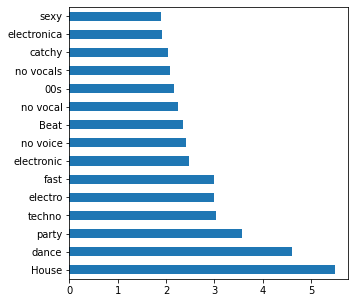

In [6]:
normed_tag_df.T.mean(axis=1).sort_values(ascending=False).iloc[:15].plot.barh(figsize=(5, 5))

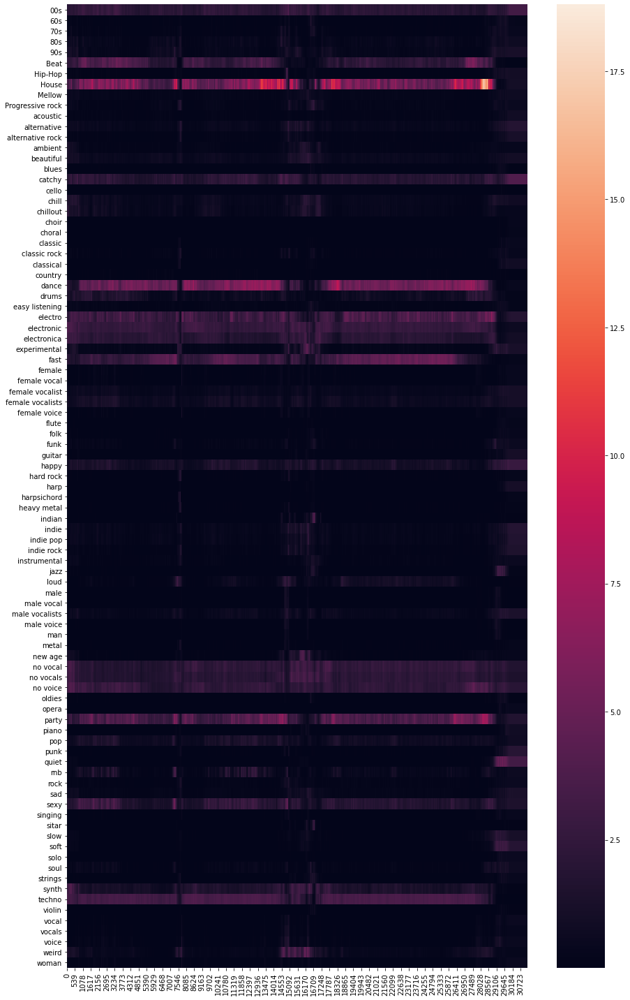

In [7]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(13, 20))
sns.heatmap(normed_tag_df.T)
plt.tight_layout()

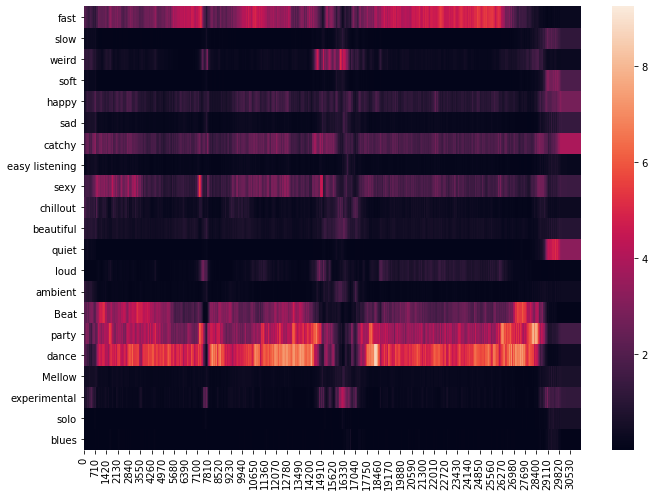

In [8]:
speed_tags = ["fast", "slow"]
feeling_tags = ["weird", "soft", "happy", "sad", "catchy", "easy listening", "sexy", "chillout", "beautiful"]
loudness_tags = ["quiet", "loud"]
vibe_tags = ["ambient", "Beat", "party", "dance", "Mellow"]

genre_like_tags = ["experimental", "solo", "blues"]

feeling_tags = speed_tags + feeling_tags + loudness_tags + vibe_tags + genre_like_tags
    
plt.figure(figsize=(10, 7))
sns.heatmap(normed_tag_df[feeling_tags].T)
plt.tight_layout()

<ipython-input-9-f7e2216bae4f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sub_df[sub_df < sub_df.mean()] = 0
/usr/local/lib/python3.8/dist-packages/pandas/core/frame.py:3713: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._where(-key, value, inplace=True)


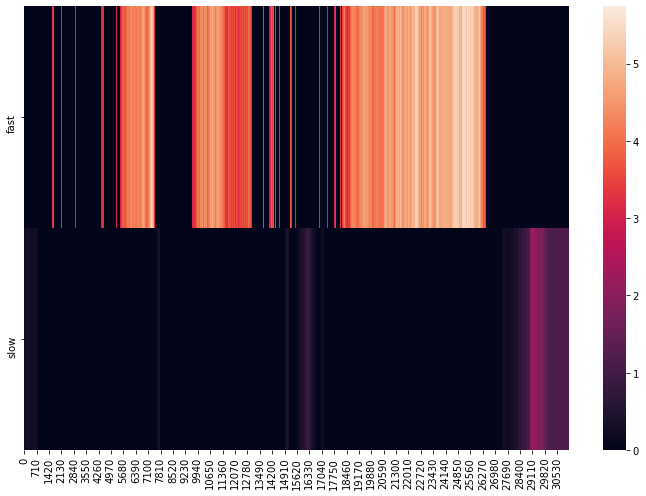

In [9]:
sub_df = normed_tag_df[["fast", "slow"]]
sub_df[sub_df < sub_df.mean()] = 0
plt.figure(figsize=(10, 7))
sns.heatmap(sub_df.T)
plt.tight_layout()

<ipython-input-10-ef2c2557391b>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loud_quiet[loud_quiet< loud_quiet.mean()] = 0


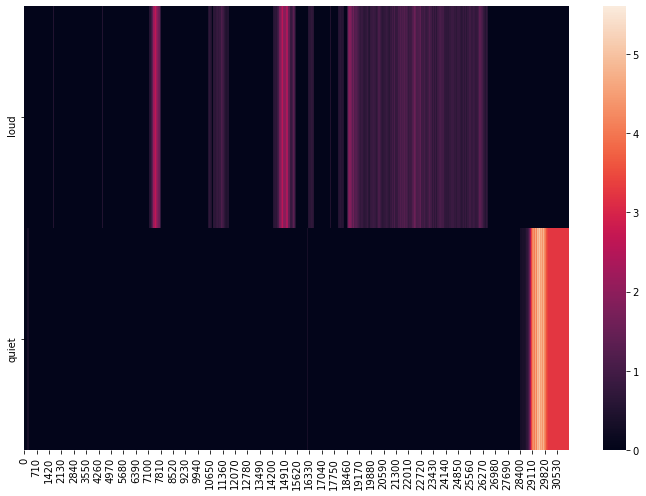

In [10]:
loud_quiet = normed_tag_df[["loud", "quiet"]]
loud_quiet[loud_quiet< loud_quiet.mean()] = 0
plt.figure(figsize=(10, 7))
sns.heatmap(loud_quiet.T)
plt.tight_layout()

<ipython-input-11-fd238f1adb75>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  happy_sad[happy_sad< happy_sad.mean()] = 0


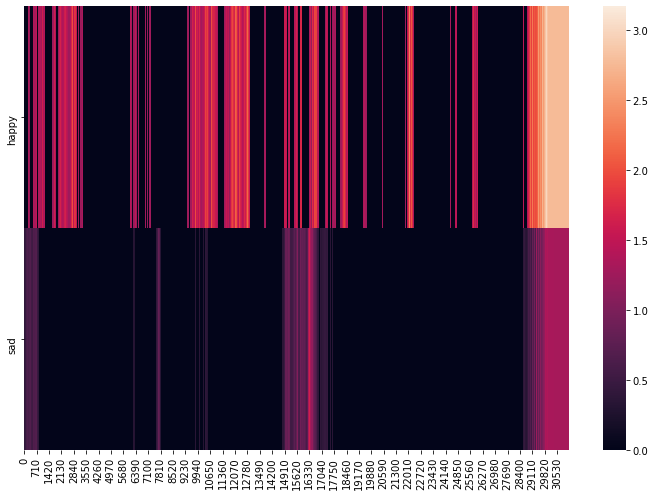

In [11]:
happy_sad = normed_tag_df[["happy", "sad"]]
happy_sad[happy_sad< happy_sad.mean()] = 0
plt.figure(figsize=(10, 7))
sns.heatmap(happy_sad.T)
plt.tight_layout()

<AxesSubplot:>

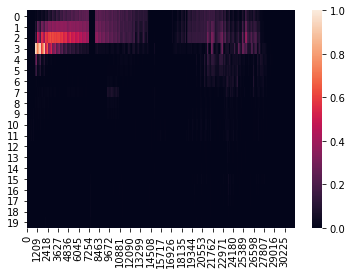

In [12]:
mel_spec = librosa.feature.melspectrogram(song, sr=16000, S=None, n_fft=512, hop_length=256, 
                                      win_length=None, window='hann', center=True, 
                                      pad_mode='reflect', power=2.0)
# Obtain maximum value per time-frame
#spec_max = np.amax(mel_spec, axis=0)
#print(spec_max.shape)
# Normalize all values between 0 and 1
#mel_spec = (mel_spec - np.min(spec_max)) / np.ptp(spec_max)

mel_spec = (mel_spec - mel_spec.min()) / (mel_spec.max() - mel_spec.min())
sns.heatmap(mel_spec[:20, :])

<AxesSubplot:>

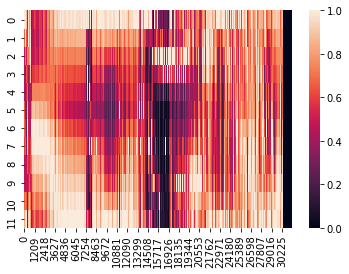

In [13]:
spec = librosa.feature.chroma_stft(song, sr=16000, S=None, n_fft=512, hop_length=256, win_length=None, window='hann', 
                            center=True, pad_mode='reflect', tuning=None, n_chroma=12)
sns.heatmap(spec)

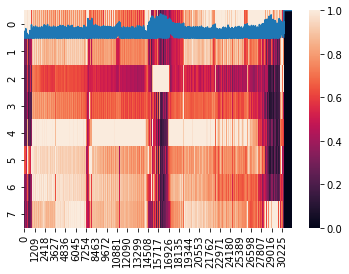

In [14]:
spec = librosa.feature.chroma_cqt(song, sr=16000, C=None, hop_length=256, fmin=None, threshold=0.0, tuning=None,
                           n_chroma=8, n_octaves=7, window=None, bins_per_octave=32, cqt_mode='full')
sns.heatmap(spec)
plt.plot(spec[0])

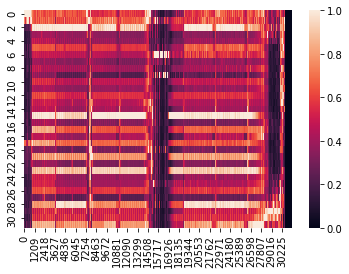

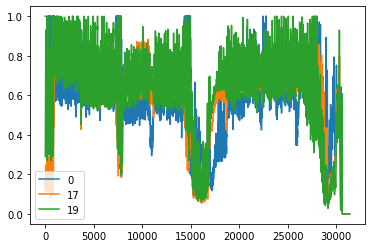

In [15]:
spec = librosa.feature.chroma_cqt(song, sr=16000, C=None, hop_length=256, fmin=None, threshold=0.0, tuning=None,
                           n_chroma=32, n_octaves=7, window=None, bins_per_octave=128, cqt_mode='full')
sns.heatmap(spec)
plt.figure()
plt.plot(spec[0], label="0")
plt.plot(spec[17], label="17")
plt.plot(spec[19], label="19")

plt.legend()

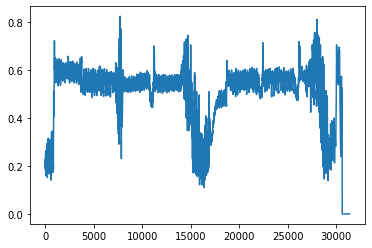

In [16]:
plt.plot(spec.mean(0))

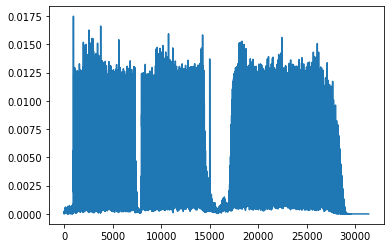

In [17]:
plt.plot(mel_spec.mean(0))

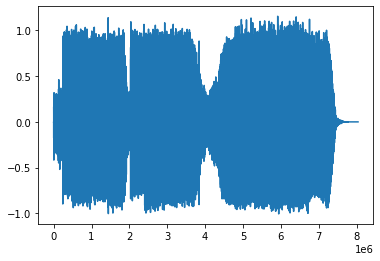

In [18]:
plt.plot(song)

In [19]:
song_harm, song_perc = librosa.effects.hpss(song)

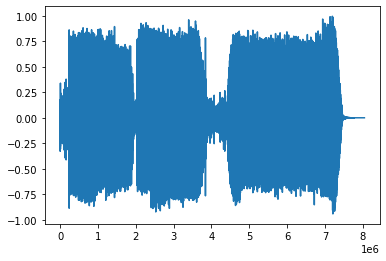

In [20]:
plt.plot(song_perc)

In [21]:
import IPython
IPython.display.Audio(song_perc, rate=16000)

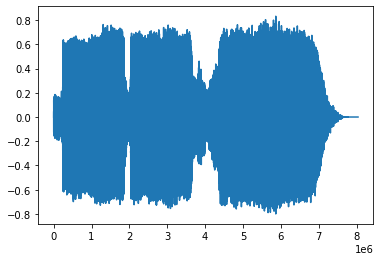

In [22]:
plt.plot(song_harm)

In [23]:
import IPython
IPython.display.Audio(song_harm, rate=16000)

In [24]:
import librosa.display

/home/anton/.local/lib/python3.8/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/home/anton/.local/lib/python3.8/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linthreshy' parameter of __init__() has been renamed 'linthresh' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)
/home/anton/.local/lib/python3.8/site-packages/librosa/display.py:974: MatplotlibDeprecationWarning: The 'linscaley' parameter of __init__() has been renamed 'linscale' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  scaler(mode, **kwargs)


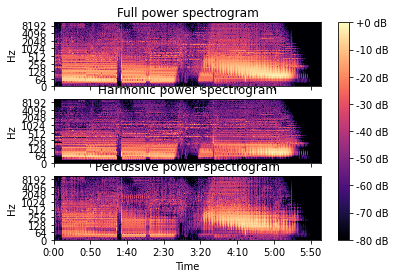

In [25]:
import numpy as np

fig, ax = plt.subplots(nrows=3, sharex=True, sharey=True)

D = librosa.stft(song)
H, P = librosa.decompose.hpss(D)

img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(D),
                                                       ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])

ax[0].set(title='Full power spectrogram')

ax[0].label_outer()
librosa.display.specshow(librosa.amplitude_to_db(np.abs(H),

                                                 ref=np.max(np.abs(D))),

                         y_axis='log', x_axis='time', ax=ax[1])

ax[1].set(title='Harmonic power spectrogram')

ax[1].label_outer()

librosa.display.specshow(librosa.amplitude_to_db(np.abs(P),

                                                 ref=np.max(np.abs(D))),

                         y_axis='log', x_axis='time', ax=ax[2])

ax[2].set(title='Percussive power spectrogram')

fig.colorbar(img, ax=ax, format='%+2.0f dB')


/home/anton/.local/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1333: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


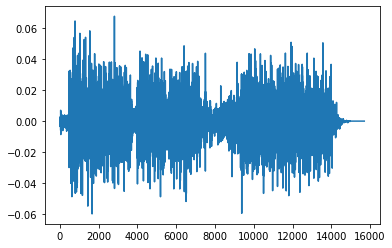

In [26]:
plt.plot(H.mean(0))

In [27]:
import torch

def gpt_create_prompt(model, tokenizer, merged_top_tags, num_beams=5):
    gpt_prompt = f"""The following are adjectives describing a song (in order of importance), followed by a description of a corresponding image:
Song description: fast, guitar, sad. Corresponding image description: A biker is racing on his motorbike while crying.
Song description: loud, techno, electronic. Corresponding image description: An illustration of dynamic and vibrant colors forming geometric shapes.
Song description: {merged_top_tags}. Corresponding image description:"""
    
    gpt_prompt_1 = f"""The following are adjectives describing a song (in order of importance), followed by a description of a corresponding image:
Song description: fast, guitar, sad. Image description: A biker is racing on his motorbike while crying.
Song description: loud, techno, electronic. Image description: An illustration of dynamic and vibrant colors forming geometric shapes.
Song description: {merged_top_tags}. Image description:"""

    
    out = model.generate(tokenizer.encode(gpt_prompt, return_tensors="pt").to(model.device),
                         top_p=0.95, do_sample=True, output_scores=True, 
                         return_dict_in_generate=True, 
                         max_length=120,
                         num_beams=num_beams, 
                         no_repeat_ngram_size=2,)
    out_text = tokenizer.decode(out["sequences"].tolist()[0])
    #print(out_text.split("Corresponding image description:")[3:])
    clip_prompt = out_text.split("image description:")[3].split("\n")[0].strip().strip('<|endoftext|>')
    return clip_prompt

def gpt_create_prompt_2(model, tokenizer, merged_top_tags, num_beams=5):
    prompter = "This is the full description of the image: "
    gpt_prompt = f"""These are some adjectives describing an image: {merged_top_tags}. {prompter}"""

    
    out = model.generate(tokenizer.encode(gpt_prompt, return_tensors="pt").to(model.device),
                         top_p=0.95, do_sample=True, output_scores=True, 
                         return_dict_in_generate=True, 
                         max_length=130,
                         num_beams=num_beams, 
                         no_repeat_ngram_size=2,)
    out_text = tokenizer.decode(out["sequences"].tolist()[0])
    #print(out_text.split("Corresponding image description:")[3:])
    clip_prompt = out_text.split(prompter)[1].strip().strip('<|endoftext|>').strip("\n")
    return clip_prompt

In [28]:
from tqdm.auto import tqdm
import numpy as np

# create musicnn prompts
theme = "A painting of crazy psychedelic geometric shapes."#"A painting of a piano being played at the beach at sunset."
k = 6
prompt_mode = "top_k" # top_k, weighted_top_k, gpt
taggram_mode = "feelings" # full, feelings

if prompt_mode == "gpt":
    from transformers import GPTNeoForCausalLM, GPT2Tokenizer
    from transformers import GPT2LMHeadModel
    device = torch.device("cuda")
    gpt_tokenizer = GPT2Tokenizer.from_pretrained("EleutherAI/gpt-neo-1.3B")
    gpt_model = GPTNeoForCausalLM.from_pretrained("EleutherAI/gpt-neo-1.3B", pad_token_id=gpt_tokenizer.eos_token_id)
    #gpt_tokenizer = GPT2Tokenizer.from_pretrained("gpt2")
    #gpt_model = GPT2LMHeadModel.from_pretrained('gpt2', pad_token_id=gpt_tokenizer.eos_token_id)
    gpt_model = gpt_model.to(device)
    prompt_hash_table = dict()

# how many steps are there to fill at the start of the song (256 is the size of the fft-windows of musicnn)
n_start_encodings = int(np.ceil((len(song) / 256 - len(tag_df))))
#start_encoding = imagine.create_text_encoding(theme)
#start_encoding = [part.to("cpu") for part in start_encoding]
#musicnn_target_encodings = [start_encoding] * n_start_encodings
clip_prompts = [theme] * n_start_encodings

if taggram_mode == "full":
    used_tag_df = normed_tag_df.copy()
elif taggram_mode == "feelings":    
    tag_df_feelings = normed_tag_df[feeling_tags].copy()
    used_tag_df = tag_df_feelings
pbar = tqdm(list(used_tag_df.iterrows()))
tag_df_means = used_tag_df.mean()

for i, row in pbar:
    row = row[row > tag_df_means]
    sorted_row = row.sort_values(ascending=False)
    # generate clip prompt
    if prompt_mode == "top_k":
        # get tags
        top_tag_names = list(sorted_row.iloc[:k].index)
        #print(top_tag_names)
        pbar.set_description(", ".join(top_tag_names))
        clip_prompt = ". ".join(top_tag_names)
        #clip_encoding = imagine.encode_text(clip_prompt)
    elif prompt_mode == "weighted_top_k":
        top_tag_names = list(sorted_row.iloc[:k].index)
        top_tag_vals = list(sorted_row.iloc[:k])
        clip_prompt = {name: val for name, val in zip(top_tag_names, top_tag_vals)}
        # average encodings
        #clip_encoding = []
        #for j in range(len(encoded_labels[list(encoded_labels)[0]])):
        #    mean_encoding = torch.stack([encoded_labels[tag_name][j] for tag_name in encoded_labels]).mean(dim=0)
        #    clip_encoding.append(mean_encoding)
    elif prompt_mode == "gpt":
        sorted_row = row.sort_values(ascending=False)
        top_tags = sorted_row.iloc[:k]
        top_tag_names = list(top_tags.index)
        if len(top_tag_names) == 0:
            top_tag_names = ["Undecided emptiness"]
        merged_top_tags = ", ".join(top_tag_names)
        if merged_top_tags in prompt_hash_table:
            clip_prompt = prompt_hash_table[merged_top_tags]
        else:
            clip_prompt = gpt_create_prompt(gpt_model, gpt_tokenizer, merged_top_tags)
            pbar.set_description("Tags: " + merged_top_tags + " Prompt: " + clip_prompt)
            #clip_encoding = imagine.create_text_encoding(clip_prompt)
            prompt_hash_table[merged_top_tags] = clip_prompt
            
    clip_prompts.append(clip_prompt)
    #clip_encoding = [part.to("cpu") for part in clip_encoding]
    #musicnn_target_encodings.append(clip_encoding)

  0%|          | 0/31222 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [29]:
if prompt_mode == "gpt":
    del gpt_tokenizer
    del gpt_model

In [30]:
import sys
sys.path.append("../StyleCLIP_modular")
from style_clip import Imagine, create_text_path
import argparse

net = "vqgan" # conv, vqgan

args = {}
args["lr_schedule"] = 0
args["seed"] = 1

args["batch_size"] = 32

args["neg_text"] = 'text, signature, watermarks, writings, scribblings'#'incoherent, confusing, cropped, watermarks'

args["circular"] = 0
args["sideX"] = 480
args["sideY"] = 480

args["clip_names"] = ["ViT-B/16", "ViT-B/32"]
args["averaging_weight"] = 0
args["early_stopping_steps"] = 0
args["use_tv_loss"] = 1
  

if net == "vqgan":
    args["model_type"] = "vqgan"
    args["lr"] = 0.1
    
elif net == "conv":
    args["model_type"] = "conv"
    args["act_func"] = "gelu"
    args["stride"] = 1
    args["num_layers"] = 5
    args["downsample"] = False
    args["norm_type"] = "layer"
    args["num_channels"] = 64
    args["sideX"] = 1080
    args["sideY"] = 720
    args["lr"] = 0.005
    args["stack_size"] = 4

args["sideX"] = 320
args["sideY"] = 180

imagine = Imagine(
                save_progress=False,
                open_folder=False,
                save_video=False,
                verbose=False,
                **args
               )

setting seed: 1
Working with z of shape (1, 256, 16, 16) = 65536 dimensions.
loaded pretrained LPIPS loss from taming/modules/autoencoder/lpips/vgg.pth
VQLPIPSWithDiscriminator running with hinge loss.


In [31]:
len(tag_df)

31222

In [32]:
used_tag_df[used_tag_df < used_tag_df.mean()] = 0

In [33]:
idx = 10
print(used_tag_df.iloc[idx].sort_values(ascending=False).iloc[:k])
clip_prompts[idx + n_start_encodings]

chillout        2.041843
weird           1.429642
ambient         1.173956
beautiful       0.978628
experimental    0.521835
sad             0.376775
Name: 10, dtype: float64


'chillout. weird. ambient. beautiful. experimental. sad'

In [34]:
idx = 15
print(used_tag_df.iloc[idx].sort_values(ascending=False).iloc[:k])
clip_prompts[idx + n_start_encodings]

chillout        1.981581
weird           1.577116
ambient         1.079518
beautiful       0.996345
experimental    0.600497
sad             0.373951
Name: 15, dtype: float64


'chillout. weird. ambient. beautiful. experimental. sad'

In [35]:
general_theme = " By James Gurney."

clip_target_encodings = []
clip_feature_hash_table = dict()

def encode(prompt):
    if general_theme is not None:
        prompt = prompt + general_theme
    if prompt in clip_feature_hash_table:
        encoding = clip_feature_hash_table[prompt]
    else:
        encoding = imagine.create_text_encoding(prompt)
        clip_feature_hash_table[prompt] = encoding
    return encoding


for prompt in tqdm(clip_prompts):
    if isinstance(prompt, dict):
        encodings = []
        weights = []
        for prompt_key in prompt:
            encoding = encode(prompt_key)
            encodings.append(encoding)
            weights.append(prompt[prompt_key])
        clip_encoding = [torch.stack([encoding[j] * weight for encoding, weight in zip(encodings, weights)]).sum(dim=0)
                         for j in range(len(encoding))]
        weight_sum = sum(weights)
        clip_encoding = [enc / weight_sum for enc in clip_encoding]
    else:
        clip_encoding = encode(prompt)
    clip_encoding = [enc.to("cpu") for enc in clip_encoding]
    clip_target_encodings.append(clip_encoding)

  0%|          | 0/31408 [00:00<?, ?it/s]

In [36]:
# take ema of encodings to smoothen
ema_encodings = []
ema = clip_target_encodings[0]
ema_val = 0.2 # 0.99 is too strong
for encoding in clip_target_encodings:
    ema = [ema_val * ema[i].to("cpu") + (1 - ema_val) * encoding[i].to("cpu") for i in range(len(encoding))]
    ema_encodings.append(ema)

In [37]:
import torch
torch.cuda.empty_cache()
import gc
gc.collect()

288

In [ ]:
from tqdm.auto import tqdm
import torchvision

sub_steps = 5
imgs = []
to_pil = torchvision.transforms.ToPILImage()
imagine.to("cuda")

for clip_encoding in tqdm(ema_encodings):
    # set it in CLIP
    clip_encoding = [part.to(imagine.device) for part in clip_encoding]
    imagine.set_clip_encoding(encoding=clip_encoding)
    # create enough images for whole transition
    for i in range(sub_steps):
        img, loss = imagine.train_step(0, 0)
    imgs.append(np.array(to_pil(img.detach().cpu().squeeze())))

  0%|          | 0/31408 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [ ]:
import os

import soundfile
import moviepy.editor as mpy
from datetime import datetime

def create_video(imgs, song, song_name, sr):
    if isinstance(imgs, list):
        img_len = len(imgs)
    else:
        img_len = len([img for img in os.listdir(imgs) 
                       if img.endswith(".jpg") or img.endswith(".png")])
    vid_fps = len(imgs) * 16000 / len(song)

    # create paths
    date_time = datetime.now().strftime("%m_%d_%H:%M")  #("%m/%d/%Y, %H:%M:%S")
    song_ref = song_name.split("/")[-1].split(".")[0]
    video_path = f"video_gens/{song_ref}_{args['model_type']}_{date_time}.mp4"
    os.makedirs("video_gens", exist_ok=True)

    # Write temporary audio file
    soundfile.write('tmp.wav', song, sr)

    # Generate final video
    audio = mpy.AudioFileClip('tmp.wav', fps=sr)
    video = mpy.ImageSequenceClip(imgs, fps=vid_fps)
    video = video.set_audio(audio)
    video.write_videofile(video_path, audio_codec='aac', fps=vid_fps)

    # Delete temporary audio file
    os.remove('tmp.wav')
    

In [ ]:
create_video(imgs, song, song_name, sr)

In [ ]:
import os
from PIL import Image

extension = ".jpg"

tmp_folder = "tmp/vid_imgs" 
os.makedirs(tmp_folder, exist_ok=True)
for i in range(len(imgs)):
    Image.fromarray(imgs[i]).save(os.path.join(tmp_folder, f"{i}{extension}"), subsampling=0, quality=95)

In [ ]:
# Clone Real-ESRGAN and enter the Real-ESRGAN
#!git clone https://github.com/xinntao/Real-ESRGAN.git
#%cd Real-ESRGAN
# Set up the environment
#!pip install basicsr
#!pip install facexlib
#!pip install gfpgan
#!pip install -r requirements.txt
#!python setup.py develop
# Download the pre-trained model
#!wget https://github.com/xinntao/Real-ESRGAN/releases/download/v0.1.0/RealESRGAN_x4plus.pth -P experiments/pretrained_models
#!wget https://github.com/xinntao/Real-ESRGAN/releases/download/v0.2.1/RealESRGAN_x2plus.pth -P experiments/pretrained_models
#%cd ..

In [ ]:
del imagine
torch.cuda.empty_cache()
gc.collect()

In [ ]:
ls tmp

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python Real-ESRGAN/inference_realesrgan.py --model_path Real-ESRGAN/experiments/pretrained_models/RealESRGAN_x4plus.pth --input "tmp/vid_imgs" --output "tmp/upscaled_vid_imgs"  --netscale 4 --outscale 4 --half --face_enhance > /dev/null

In [ ]:
def load_img_paths(root):
    paths = [os.path.join(root, f) for f in os.listdir(root)
        if f.endswith(".png") or f.endswith(".jpg")]
    paths = sorted(paths, key= lambda x: int(x.split("/")[-1].split("_")[0]))
    return paths

In [ ]:
new_song_name = song_name.split("/")
new_song_name[-1] = "HD_" + new_song_name[-1]
new_song_name = "/".join(new_song_name)

root = "tmp/upscaled_vid_imgs"
paths = load_img_paths(root)
create_video(paths, song, new_song_name, sr)

In [ ]:
torch.cuda.empty_cache()
gc.collect()

In [ ]:
!CUDA_VISIBLE_DEVICES=0 python Real-ESRGAN/inference_realesrgan.py --model_path Real-ESRGAN/experiments/pretrained_models/RealESRGAN_x2plus.pth --input  "tmp/upscaled_vid_imgs" --output "tmp/twice_upscaled_vid_imgs"  --netscale 2 --outscale 2 --half --face_enhance > /dev/null
#!python inference_realesrgan.py --model_path experiments/pretrained_models/RealESRGAN_x4plus.pth --input "tmp/upscaled_vid_imgs" --output "tmp/twice_upscaled_vid_imgs"  --netscale 4 --outscale 3.5 --half --face_enhance

In [ ]:
latest_song_name = new_song_name.split("/")
latest_song_name[-1] = "Full" + latest_song_name[-1]
latest_song_name = "/".join(latest_song_name)
root = "tmp/twice_upscaled_vid_imgs"
paths = load_img_paths(root)
create_video(paths, song, latest_song_name, sr)

In [ ]:
"""
## complex:

total_steps = 400
pixel_step_size_x = 0
pixel_step_size_y = 0
opt_steps = 30
zoom_factor = 1.04 #0.9
#zoom_factor = 1#1.02
angle = 2
shear = 0
slerp_steps = 0

translate_settings = f"net-{net}_steps{total_steps}_move{pixel_step_size_x}-{pixel_step_size_y}_rot{angle}_zoom{zoom_factor}_optfor{opt_steps}"

# setup starting latent and goal
imagine.set_clip_encoding(text=prompt)#, img=path_dict[prompt], encoding=None)
imagine.set_latent(latent)
latent_transition = [latent]
from torchvision.transforms.functional import InterpolationMode

zoom_latent = False

for _ in tqdm(range(total_steps)):
    # recreate img
    if net == "vqgan":
        if zoom_latent:
            img = latent
        else:
            img = decode(imagine, latent)
    elif net == "conv":
        img, params = imagine.model.model.get_latent(device="cpu")
    # transform it
    transformed = T.functional.affine(img, angle=angle, 
                                      translate=(pixel_step_size_x, pixel_step_size_y), 
                                      scale=zoom_factor, 
                                      shear=shear,
                                      interpolation=InterpolationMode.BILINEAR)

    if net == "vqgan":
        if zoom_latent:
            latent = transformed
        else:
            # encode it again
            latent, _, [_, _, indices] = vqgan.encode(transformed.to(imagine.device).mul(2).sub(1))
    elif net == "conv":
        latent = [transformed, params]

    # set latent in imagine properly such that it can be optimized by the optimzier
    imagine.set_latent(latent)

    for _ in range(opt_steps):
        imagine.train_step(0, 0)

    # get new latents
    latent = imagine.model.model.get_latent(device="cpu")
    # store latents
    latent_transition.append(latent)
"""